# Lab 8 Recursion

Lecturer: <code>Sirasit Lochanachit</code>

Course:

<code>01526102 Data Structures and Algorithms [SIIE]
</code>

Term: <code>02/2024</code>

---

In [49]:
import timeit
import random
import matplotlib.pyplot as plt
import numpy as np

In [ ]:
%matplotlib inline
plt.rcParams['figure.figsize'] = [12, 8] # set size of plot

# Lab 8-1: Linear/Sequential Search (Again)

## Problem Description

Your task is to implement a function `linear_search_recursive(data, target)` that that takes a list `data` and a target value `target` as input.

The function should perform a linear search to find the index of the `target` within the `data`.

## Requirement
- loop is not allowed, use **recursion** approach only
- If the target is found, return its `index`
- If the target is not found, return `False`



In [ ]:
def linear_search_iterative(data, target):
    for i in range(len(data)):
        if data[i] == target:
            #print("Found target at index", i)
            return i
    #print("Target not Found")
    return False

In [ ]:
def linear_search_recursive(data, target, index=0):
    # Base Case 1: If index reaches the end of the list, return False
    if index == len(data):
        return False

    # Base Case 2: If the current element matches the target, return the index
    if data[index] == target:
        return index

    # Recursive Case: Increment the index and call the function recursively
    return linear_search_recursive(data, target, index + 1)

In [ ]:
data = [10,20,40,50]
linear_search_recursive(data,40)

2

In [ ]:
linear_search_recursive(data,100)

False

## Compare running time between iterative and recursive linear search

For the following codes, if your PC/colab encountered *Maximum depth recursion Error*, try reduce the max number of input size.

In [ ]:
ns = np.linspace(100, 1000, 50, dtype=int)

ts_linsearch_iter = [timeit.timeit('linear_search_iterative(lst, lst[-1])',
                              setup=f'lst = list(range({n}))',
                              globals=globals(),
                              number=10)
                for n in ns]

ts_linsearch_recur = [timeit.timeit('linear_search_recursive(lst, lst[-1])',
                              setup=f'lst = list(range({n}))',
                              globals=globals(),
                              number=10)
                for n in ns]

RecursionError: maximum recursion depth exceeded

NameError: name 'ts_linsearch_recur' is not defined

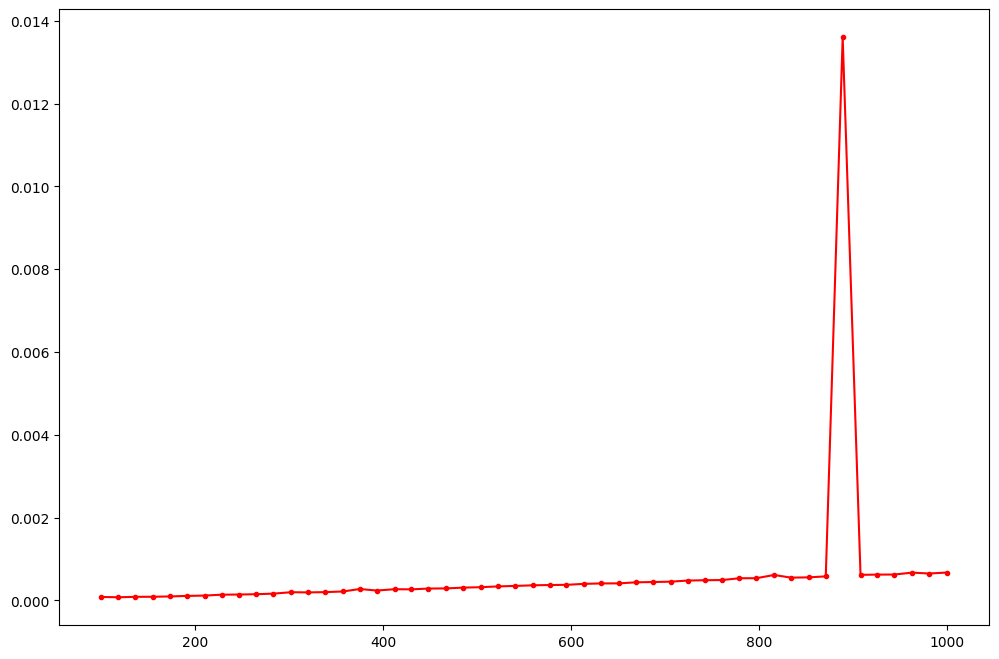

In [ ]:
plt.plot(ns, ts_linsearch_iter, '.r-') # Square Red
plt.plot(ns, ts_linsearch_recur, '.g-') # Square Green
plt.xlabel('Number of elements')
plt.ylabel('Time (s)')
plt.title('Linear Search Iterative vs Recursive')
plt.legend(['Linear Search Iterative', 'Linear Search Recursive'])

---

# Lab 8-2: Fibonacci Numbers

## Problem Description

The Fibonacci numbers, commonly denoted as F(n), form a sequence such that each number is the sum of the two preceding ones, starting from 0 and 1. That is:

- F(0) = 0
- F(1) = 1
- F(n) = F(n - 1) + F(n - 2), for n > 1

Write a recursive function in Python that calculates the *n*th Fibonacci number given an integer `n`.

## Constraints
- 0 ≤ n ≤ 30
- The function should be implemented using **recursion**.
- If `n` is negative, the function should raise a `ValueError`.



In [ ]:
def fibonacci(n):
    ########################
    ## Add your code here
    ########################
    # Handle negative input
    if n < 0:
        raise ValueError("Input must be a non-negative integer.")
    # Base cases
    if n == 0:
        return 0
    if n == 1:
        return 1
    # Recursive step
    return fibonacci(n - 1) + fibonacci(n - 2)
    pass

## Structured Test Cases

Run the following code and see the result:
- If all tests pass, you'll see 'All test cases passed' (which is good!).
- If a test fails, you'll see an AssertionError indicating which test case failed and why.

In [ ]:
def test_fibonacci():
    # Base cases
    assert fibonacci(0) == 0, "Test Case 1 Failed"
    assert fibonacci(1) == 1, "Test Case 2 Failed"

    # Small positive cases
    assert fibonacci(2) == 1, "Test Case 3 Failed"
    assert fibonacci(3) == 2, "Test Case 4 Failed"
    assert fibonacci(4) == 3, "Test Case 5 Failed"

    # Larger cases
    assert fibonacci(5) == 5, "Test Case 6 Failed"
    assert fibonacci(6) == 8, "Test Case 7 Failed"
    assert fibonacci(7) == 13, "Test Case 8 Failed"
    assert fibonacci(10) == 55, "Test Case 9 Failed"

    # Edge case: Negative number should raise ValueError
    try:
        fibonacci(-1)
        assert False, "Test Case 10 Failed: No Exception Raised"
    except ValueError:
        pass

    print("\n#############################################")
    print("All test cases passed!")
    print("#############################################")

# Test cases
if __name__ == "__main__":
    test_fibonacci()


#############################################
All test cases passed!
#############################################


---

# Lab 8-3: Palindrome

## Problem Description

A palindrome is a string that reads the same forward and backward.

Write a recursive function in Python to check whether a given string is a palindrome.

### Input
- A string `s` consisting of lowercase English letters (1 ≤ |s| ≤ 1000).
### Output
- Returns `True` if the string is a palindrome, otherwise False.

## Constraints
- The function should be implemented using recursion.
- The function should not use loops or built-in reverse functions (e.g., `s[::-1]`).
- The function should handle edge cases, including single-character strings and empty strings.



In [ ]:
def is_palindrome(s: str) -> bool:
    # Base cases and recursive case

    ########################
    ## Add your code here
    ########################

    # Base case: empty or single-character string is a palindrome
    if len(s) <= 1:
        return True
    # Check first and last characters
    if s[0] != s[-1]:
        return False
    # Recursive case: check the substring excluding the first and last characters
    return is_palindrome(s[1:-1])

    pass


### Testing Codes

In [ ]:
# Example usage
print(is_palindrome("racecar"))  # Expected output: True
print(is_palindrome("hello"))    # Expected output: False

True
False


## Structured Test Cases

Run the following code and see the result:
- If all tests pass, you'll see 'All test cases passed' (which is good!).
- If a test fails, you'll see an AssertionError indicating which test case failed and why.

In [ ]:
def test_is_palindrome():
    # Base cases
    assert is_palindrome("") == True   # Empty string is a palindrome
    assert is_palindrome("a") == True  # Single character is a palindrome

    # Simple palindromes
    assert is_palindrome("racecar") == True
    assert is_palindrome("madam") == True
    assert is_palindrome("radar") == True

    # Non-palindromes
    assert is_palindrome("hello") == False
    assert is_palindrome("python") == False
    assert is_palindrome("openai") == False

    # Even-length palindrome
    assert is_palindrome("abba") == True
    assert is_palindrome("deed") == True

    # Even-length non-palindrome
    assert is_palindrome("abcd") == False
    assert is_palindrome("abab") == False

    print("\n#############################################")
    print("All test cases passed!")
    print("#############################################")

# Test cases
if __name__ == "__main__":
    test_is_palindrome()


#############################################
All test cases passed!
#############################################


---

# Challenge 8: Implement Merge Sort in ascending order (lower numbers to higher numbers)

Two distinct processes:
1. Splitting: Requires $\log n$ operations
2. Merging: Require $n$ operations

Therefore, a total of $n \log n$ operations, $O(n \log n)$.

Note: mergesort requires extra memory space to hold two halves. This can be a critical factor if the list is large.

## 1. Implement Merge Sort using iterative approach (non-recursive)

In [ ]:
def merge_sort_iterative(arr):
    current_size = 1

    # Outer loop for traversing each sub array of current_size
    while current_size < len(arr) - 1:

        # Splitting Stage

        left = 0
        # Inner loop for merge call in a sub array
        # Each complete iteration sorts the iterating sub array
        while left < len(arr)-1:

            # mid index = left index of sub array + current sub array size - 1
            mid = min((left + current_size - 1), (len(arr)-1))

            # (False result,True result) for last sub array if length is not even
            right = ((2 * current_size + left - 1, len(arr) - 1)
                     [2 * current_size + left - 1 > len(arr)-1])

            # Merge call for each sub array
            print(f'Merging : {arr}')
            merge(arr, left, mid, right)
            left = left + current_size*2

        # Increasing sub array size by multiple of 2
        current_size = 2 * current_size

# Merging State
def merge(arr, l, m, r):
    n1 = m - l + 1
    n2 = r - m
    L = [0] * n1
    R = [0] * n2

    for i in range(0, n1):
        L[i] = arr[l + i]

    for i in range(0, n2):
        R[i] = arr[m + 1 + i]

    i = 0
    j = 0
    k = l

    while i < n1 and j < n2:
        if L[i] > R[j]:
            arr[k] = R[j]
            j += 1
        else:
            arr[k] = L[i]
            i += 1
        k += 1

    while i < n1:
        arr[k] = L[i]
        i += 1
        k += 1

    while j < n2:
        arr[k] = R[j]
        j += 1
        k += 1


In [ ]:
# Example usage
data = [12, 11, 13, 5, 6, 7]
print("Original list is:", data)
merge_sort_iterative(data)
print("Sorted list is:", data)

Original list is: [12, 11, 13, 5, 6, 7]
Merging : [12, 11, 13, 5, 6, 7]
Merging : [11, 12, 13, 5, 6, 7]
Merging : [11, 12, 5, 13, 6, 7]
Merging : [11, 12, 5, 13, 6, 7]
Merging : [5, 11, 12, 13, 6, 7]
Merging : [5, 11, 12, 13, 6, 7]
Sorted list is: [5, 6, 7, 11, 12, 13]


## 2. Implement Merge Sort using recursive approach

Hint: Merging stage can be implemented similar to merging stage from an iterative version.

In [ ]:
def merge_sort_recursive(alist):
    print("Splitting ",alist)
    print("\n")
    if len(alist) > 1:            # len > 1, otherwise, list is sorted

        # Splitting stage

        mid = len(alist) // 2     # Finding the mid of the array
        L = alist[:mid]           # Dividing the elements into 2 halves
        R = alist[mid:]

        merge_sort_recursive(L)              # Sorting the first half
        merge_sort_recursive(R)               # Sorting the second half

        # Merging stage

        i = j = k = 0

        ##########################
        ## Add your code here
        ##########################

        while i < len(L) and j < len(R):
            if L[i] <= R[j]:
                alist[k] = L[i]
                i += 1
            else:
                alist[k] = R[j]
                j += 1
            k += 1

        while i < len(L):
            alist[k] = L[i]
            i += 1
            k += 1

        while j < len(R):
            alist[k] = R[j]
            j += 1
            k += 1



    print("Merging ",alist, "\n")


In [ ]:
# Example usage
data = [12, 11, 13, 5, 6, 7]
print("Original list is:", data)
merge_sort_recursive(data)
print("Sorted list is:", data)

Original list is: [12, 11, 13, 5, 6, 7]
Splitting  [12, 11, 13, 5, 6, 7]


Splitting  [12, 11, 13]


Splitting  [12]


Merging  [12] 

Splitting  [11, 13]


Splitting  [11]


Merging  [11] 

Splitting  [13]


Merging  [13] 

Merging  [11, 13] 

Merging  [11, 12, 13] 

Splitting  [5, 6, 7]


Splitting  [5]


Merging  [5] 

Splitting  [6, 7]


Splitting  [6]


Merging  [6] 

Splitting  [7]


Merging  [7] 

Merging  [6, 7] 

Merging  [5, 6, 7] 

Merging  [5, 6, 7, 11, 12, 13] 

Sorted list is: [5, 6, 7, 11, 12, 13]


## 3. Compare running time between iterative and recursive merge sort

In [ ]:
ns = np.linspace(100, 1000, 50, dtype=int)

In [ ]:
# Copy your iterative merge sort function without printing anything
def merge_sort_iterative(arr):
    current_size = 1

    # Outer loop for traversing each sub array of current_size
    while current_size < len(arr) - 1:

        # Splitting Stage

        left = 0
        # Inner loop for merge call in a sub array
        # Each complete iteration sorts the iterating sub array
        while left < len(arr)-1:

            # mid index = left index of sub array + current sub array size - 1
            mid = min((left + current_size - 1), (len(arr)-1))

            # (False result,True result) for last sub array if length is not even
            right = ((2 * current_size + left - 1, len(arr) - 1)
                     [2 * current_size + left - 1 > len(arr)-1])

            # Merge call for each sub array
            print(f'Merging : {arr}')
            merge(arr, left, mid, right)
            left = left + current_size*2

        # Increasing sub array size by multiple of 2
        current_size = 2 * current_size

# Merging State
def merge(arr, l, m, r):
    n1 = m - l + 1
    n2 = r - m
    L = [0] * n1
    R = [0] * n2

    for i in range(0, n1):
        L[i] = arr[l + i]

    for i in range(0, n2):
        R[i] = arr[m + 1 + i]

    i = 0
    j = 0
    k = l

    while i < n1 and j < n2:
        if L[i] > R[j]:
            arr[k] = R[j]
            j += 1
        else:
            arr[k] = L[i]
            i += 1
        k += 1

    while i < n1:
        arr[k] = L[i]
        i += 1
        k += 1

    while j < n2:
        arr[k] = R[j]
        j += 1
        k += 1


In [ ]:
# Copy your recursive merge sort function without printing anything
def merge_sort_recursive(alist):
    print("Splitting ",alist)
    print("\n")
    if len(alist) > 1:            # len > 1, otherwise, list is sorted

        # Splitting stage

        mid = len(alist) // 2     # Finding the mid of the array
        L = alist[:mid]           # Dividing the elements into 2 halves
        R = alist[mid:]

        merge_sort_recursive(L)              # Sorting the first half
        merge_sort_recursive(R)               # Sorting the second half

        # Merging stage

        i = j = k = 0

        ##########################
        ## Add your code here
        ##########################

        while i < len(L) and j < len(R):
            if L[i] <= R[j]:
                alist[k] = L[i]
                i += 1
            else:
                alist[k] = R[j]
                j += 1
            k += 1

        while i < len(L):
            alist[k] = L[i]
            i += 1
            k += 1

        while j < len(R):
            alist[k] = R[j]
            j += 1
            k += 1



    print("Merging ",alist, "\n")



### List is sorted

In [ ]:
ts_mergesort_iter = [timeit.timeit('merge_sort_iterative(lst)',
                              setup=f'lst = list(range({n}))',
                              globals=globals(),
                              number=10)
                for n in ns]

ts_mergesort_recur = [timeit.timeit('merge_sort_recursive(lst)',
                              setup=f'lst = list(range({n}))',
                              globals=globals(),
                              number=10)
                for n in ns]

Streaming output truncated to the last 5000 lines.
Merging : [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209

In [ ]:
plt.plot(ns, ts_mergesort_iter, '.r-') # Square Red
plt.plot(ns, ts_mergesort_recur, '.g-') # Square Green
plt.xlabel('Number of elements')
plt.ylabel('Time (s)')
plt.title('Merge Sort Iterative vs Recursive')
plt.legend(['Iterative', 'Recursive'])

### Numerical elements are randomly selected (random list)

In [ ]:
ts_mergesort_iter = [timeit.timeit('merge_sort_iterative(lst)',
                              setup=f'lst = random.sample(range({n} * 2), {n})',
                              globals=globals(),
                              number=10)
                for n in ns]

ts_mergesort_recur = [timeit.timeit('merge_sort_recursive(lst)',
                              setup=f'lst = random.sample(range({n} * 2), {n})',
                              globals=globals(),
                              number=10)
                for n in ns]

NameError: name 'ns' is not defined

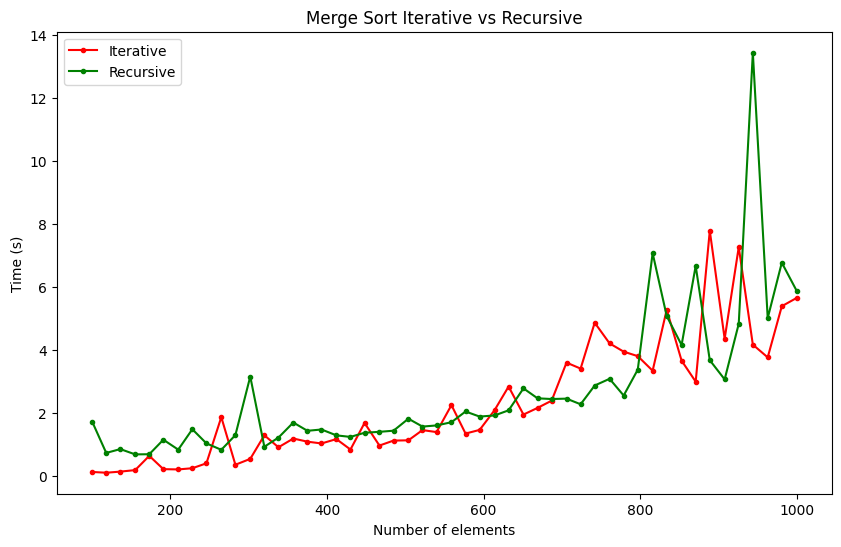

In [50]:
plt.figure(figsize=(10, 6))
plt.plot(ns, ts_mergesort_iter, '.r-') # Square Red
plt.plot(ns, ts_mergesort_recur, '.g-') # Square Green
plt.xlabel('Number of elements')
plt.ylabel('Time (s)')
plt.title('Merge Sort Iterative vs Recursive')
plt.legend(['Iterative', 'Recursive'])